In [1]:
import os
import pandas as pd
import numpy as np
from PIL import Image
from matplotlib import pyplot as plt

## Create dataset for GUI Annotation

The starting csv is `../coris_db_subsets/AMD/Fundus_Auto_Fluorescence/OptimEYES_Prospective/OptimEYES_Prospective_GA_ICD_Code_Cohort.csv`. From this csv, the duplicated filepaths are dropped using pandas to give the csv below..

In [41]:
path = '../coris_db_subsets/AMD/Fundus_Auto_Fluorescence/OptimEYES_Prospective/OptimEYES_Prospective_GA_ICD_Code_Cohort_dropped.csv'
df = pd.read_csv(path)
df

,file_path_coris,fileeye,devdescription,filenote,year,month,day,pat_mrn,code,code_type
0,/data/PACS/VisupacImages/1000/397170/axis01_10...,OD,Spectralis OCT (Scans),(4738) Single,2021,1,11,2177902,362.51,ICD-9
1,/data/PACS/VisupacImages/1000/397170/axis01_10...,OS,Spectralis OCT (Scans),(4741) Single,2021,1,11,2177902,362.51,ICD-9
2,/data/PACS/VisupacImages/1003/116307/AxisUCH01...,OD,Spectralis OCT (Scans),(201844) Single,2016,4,13,1230939,H35.3113,ICD-10
3,/data/PACS/VisupacImages/1003/116307/AxisUCH01...,OD,Spectralis OCT (Scans),(201844) Single,2016,4,13,1230939,H35.3113,ICD-10
4,/data/PACS/VisupacImages/1003/116307/AxisUCH01...,OD,Spectralis OCT (Scans),(201844) Single,2016,4,13,1230939,H35.3113,ICD-10
...,...,...,...,...,...,...,...,...,...,...
7339,/data/PACS/VisupacImages/994/542402/axis01_994...,OD,Spectralis OCT (Scans),(824239) Single,2022,8,25,342389,362.51,ICD-9
7340,/data/PACS/VisupacImages/994/542402/axis01_994...,OS,Spectralis OCT (Scans),(824237) Single,2022,8,25,342389,362.51,ICD-9
7341,/data/PACS/VisupacImages/9988/418121/axis01_99...,OS,Spectralis OCT (Scans),(8590) Single,2021,4,8,1855071,362.51,ICD-9
7342,/data/PACS/VisupacImages/9988/418121/axis01_99...,OS,Spectralis OCT (Scans),(8590) Single,2021,4,8,1855071,362.51,ICD-9


In [42]:
tulisa_mrns_path = '../coris_db_subsets/AMD/Fundus_Auto_Fluorescence/OptimEYES_Prospective/AMD_Epi_GA_Size_Cohort_1_2.csv'
tulisa_df = pd.read_csv(anne_mrns_path)
mrns_remove = tulisa_df['MRN'].unique()

In [43]:
len(mrns_remove)

174

In [44]:
df_new = df[~df.pat_mrn.isin(mrns_remove)]

In [45]:
df_new

,file_path_coris,fileeye,devdescription,filenote,year,month,day,pat_mrn,code,code_type
0,/data/PACS/VisupacImages/1000/397170/axis01_10...,OD,Spectralis OCT (Scans),(4738) Single,2021,1,11,2177902,362.51,ICD-9
1,/data/PACS/VisupacImages/1000/397170/axis01_10...,OS,Spectralis OCT (Scans),(4741) Single,2021,1,11,2177902,362.51,ICD-9
2,/data/PACS/VisupacImages/1003/116307/AxisUCH01...,OD,Spectralis OCT (Scans),(201844) Single,2016,4,13,1230939,H35.3113,ICD-10
3,/data/PACS/VisupacImages/1003/116307/AxisUCH01...,OD,Spectralis OCT (Scans),(201844) Single,2016,4,13,1230939,H35.3113,ICD-10
4,/data/PACS/VisupacImages/1003/116307/AxisUCH01...,OD,Spectralis OCT (Scans),(201844) Single,2016,4,13,1230939,H35.3113,ICD-10
...,...,...,...,...,...,...,...,...,...,...
7339,/data/PACS/VisupacImages/994/542402/axis01_994...,OD,Spectralis OCT (Scans),(824239) Single,2022,8,25,342389,362.51,ICD-9
7340,/data/PACS/VisupacImages/994/542402/axis01_994...,OS,Spectralis OCT (Scans),(824237) Single,2022,8,25,342389,362.51,ICD-9
7341,/data/PACS/VisupacImages/9988/418121/axis01_99...,OS,Spectralis OCT (Scans),(8590) Single,2021,4,8,1855071,362.51,ICD-9
7342,/data/PACS/VisupacImages/9988/418121/axis01_99...,OS,Spectralis OCT (Scans),(8590) Single,2021,4,8,1855071,362.51,ICD-9


In [46]:
df_new = df_new[df_new['file_path_coris'].apply(lambda x: os.path.exists(x))]

In [47]:
df_new

,file_path_coris,fileeye,devdescription,filenote,year,month,day,pat_mrn,code,code_type
0,/data/PACS/VisupacImages/1000/397170/axis01_10...,OD,Spectralis OCT (Scans),(4738) Single,2021,1,11,2177902,362.51,ICD-9
1,/data/PACS/VisupacImages/1000/397170/axis01_10...,OS,Spectralis OCT (Scans),(4741) Single,2021,1,11,2177902,362.51,ICD-9
2,/data/PACS/VisupacImages/1003/116307/AxisUCH01...,OD,Spectralis OCT (Scans),(201844) Single,2016,4,13,1230939,H35.3113,ICD-10
3,/data/PACS/VisupacImages/1003/116307/AxisUCH01...,OD,Spectralis OCT (Scans),(201844) Single,2016,4,13,1230939,H35.3113,ICD-10
4,/data/PACS/VisupacImages/1003/116307/AxisUCH01...,OD,Spectralis OCT (Scans),(201844) Single,2016,4,13,1230939,H35.3113,ICD-10
...,...,...,...,...,...,...,...,...,...,...
7339,/data/PACS/VisupacImages/994/542402/axis01_994...,OD,Spectralis OCT (Scans),(824239) Single,2022,8,25,342389,362.51,ICD-9
7340,/data/PACS/VisupacImages/994/542402/axis01_994...,OS,Spectralis OCT (Scans),(824237) Single,2022,8,25,342389,362.51,ICD-9
7341,/data/PACS/VisupacImages/9988/418121/axis01_99...,OS,Spectralis OCT (Scans),(8590) Single,2021,4,8,1855071,362.51,ICD-9
7342,/data/PACS/VisupacImages/9988/418121/axis01_99...,OS,Spectralis OCT (Scans),(8590) Single,2021,4,8,1855071,362.51,ICD-9


In [48]:
df_new.to_csv('Fundus_Auto_Fluorescence/OptimEYES_Prospective/OptimEYES_Prospective_GA_ICD_Code_Cohort_toinspect.csv', index=False)

## Get good quality autofluorescence images

In [3]:
path = '../coris_db_subsets/AMD/Fundus_Auto_Fluorescence/OptimEYES_Prospective/OptimEYES_Prospective_GA_ICD_Code_Cohort_inspected.csv'
df = pd.read_csv(path)
df.head()

,file_path_coris,fileeye,devdescription,filenote,year,month,day,pat_mrn,code,code_type,Good_Quality
0,coris_db_subsets/AMD/Fundus_Auto_Fluorescence/...,OD,Spectralis OCT (Scans),(4738) Single,2021,1,11,2177902,362.51,ICD-9,0
1,coris_db_subsets/AMD/Fundus_Auto_Fluorescence/...,OS,Spectralis OCT (Scans),(4741) Single,2021,1,11,2177902,362.51,ICD-9,0
2,coris_db_subsets/AMD/Fundus_Auto_Fluorescence/...,OD,Spectralis OCT (Scans),(201844) Single,2016,4,13,1230939,H35.3113,ICD-10,2
3,coris_db_subsets/AMD/Fundus_Auto_Fluorescence/...,OD,Spectralis OCT (Scans),(201844) Single,2016,4,13,1230939,H35.3113,ICD-10,2
4,coris_db_subsets/AMD/Fundus_Auto_Fluorescence/...,OD,Spectralis OCT (Scans),(201844) Single,2016,4,13,1230939,H35.3113,ICD-10,2


In [31]:
df_good_quality_1 = df[df['Good_Quality'] == '1']
df_good_quality_2 = df[df['Good_Quality'] == '2']
good_quality_files_1 = df_good_quality_1.file_path_coris.tolist()
good_quality_files_2 = df_good_quality_2.file_path_coris.tolist()

# selected files
files_1 = [2, 3, 4, 5, 12, 16, 27, 30, 31, 33, 35, 41, 43, 44, 48, 49, 51, 61, 63, 66, 67, 68, 69, 73, 79, 82, 83, 86, 87, 90, 93, 95, 102, 103, 105, 116, 119, 128, 130, 134, 136, 137, 138, 150, 153, 156, 159, 163, 164, 165, 167, 172, 176, 178, 180]
files_2 = [12, 19, 24, 28, 29, 34, 36, 37, 41, 45, 60, 65, 75, 78, 80, 83]

all_good_quality_files = [good_quality_files_1[i] for i in files_1] + [good_quality_files_2[i] for i in files_2]
df_all_good_quality_files = df[df.file_path_coris.isin(all_good_quality_files)]
df_all_good_quality_files

,file_path_coris,fileeye,devdescription,filenote,year,month,day,pat_mrn,code,code_type,Good_Quality
29,coris_db_subsets/AMD/Fundus_Auto_Fluorescence/...,OD,Spectralis OCT (Scans),(699840) Single,2021,10,4,3586350,H35.3123,ICD-10,1
31,coris_db_subsets/AMD/Fundus_Auto_Fluorescence/...,OS,Spectralis OCT (Scans),(699841) Single,2021,10,4,3586350,H35.3123,ICD-10,1
33,coris_db_subsets/AMD/Fundus_Auto_Fluorescence/...,OD,Spectralis OCT (Scans),(699840) Single,2021,10,4,3586350,H35.3123,ICD-10,1
38,coris_db_subsets/AMD/Fundus_Auto_Fluorescence/...,OS,Spectralis OCT (Scans),(861326) Single,2022,11,23,3586350,H35.3123,ICD-10,1
73,coris_db_subsets/AMD/Fundus_Auto_Fluorescence/...,OD,Spectralis OCT (Scans),(172663) Single,2015,6,23,1483008,362.51,ICD-9,1
...,...,...,...,...,...,...,...,...,...,...,...
1891,coris_db_subsets/AMD/Fundus_Auto_Fluorescence/...,OS,Spectralis OCT (Scans),(771966) Single,2022,4,14,661781,H35.3123,ICD-10,1
1905,coris_db_subsets/AMD/Fundus_Auto_Fluorescence/...,OD,Spectralis OCT (Scans),(167308) Single,2015,5,19,5279829,362.51,ICD-9,2
1935,coris_db_subsets/AMD/Fundus_Auto_Fluorescence/...,OS,Spectralis OCT (Scans),(170391) Single,2015,6,9,2123459,362.51,ICD-9,1
1949,coris_db_subsets/AMD/Fundus_Auto_Fluorescence/...,OS,Spectralis OCT (Scans),(256395) Single,2017,6,21,1360914,H35.3113,ICD-10,1


In [32]:
df_all_good_quality_files.to_csv('../coris_db_subsets/AMD/Fundus_Auto_Fluorescence/OptimEYES_Prospective/OptimEYES_Prospective_GA_ICD_Code_Cohort_good_quality_only.csv', index=False)

Image 0


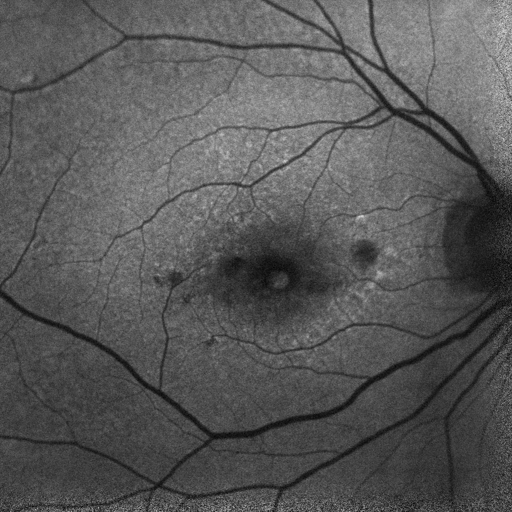

Image 1


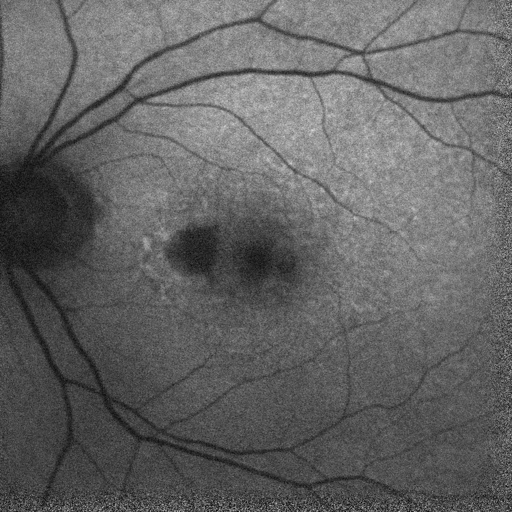

Image 2


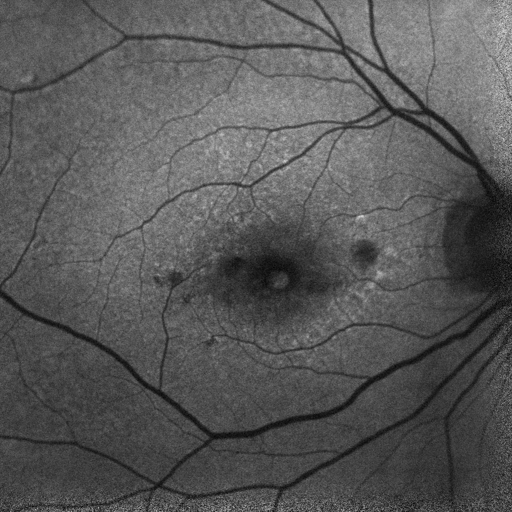

Image 3


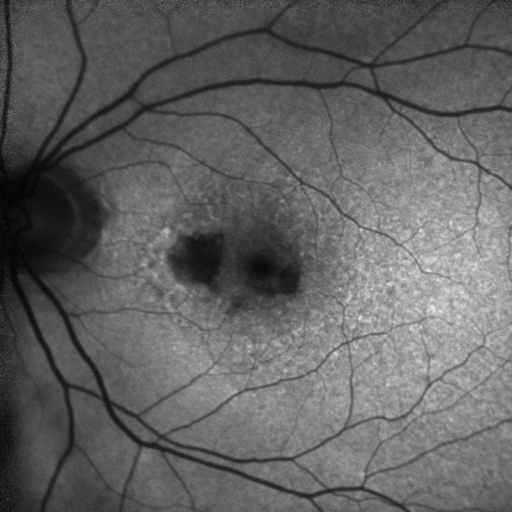

Image 4


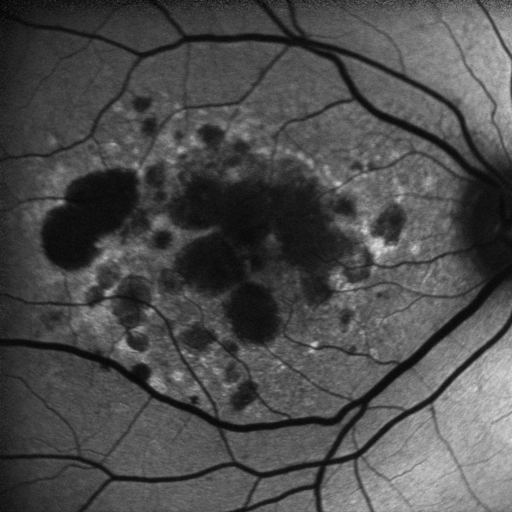

Image 5


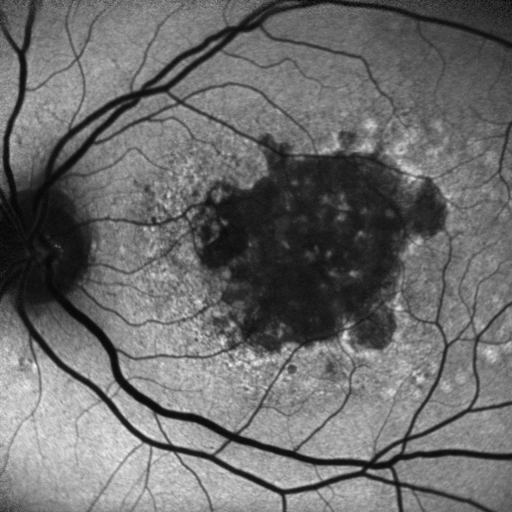

Image 6


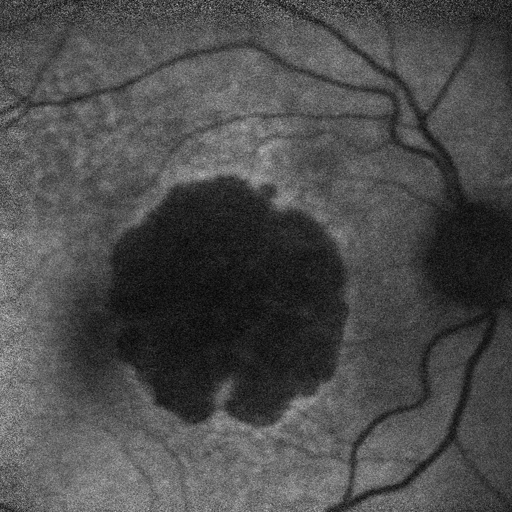

Image 7


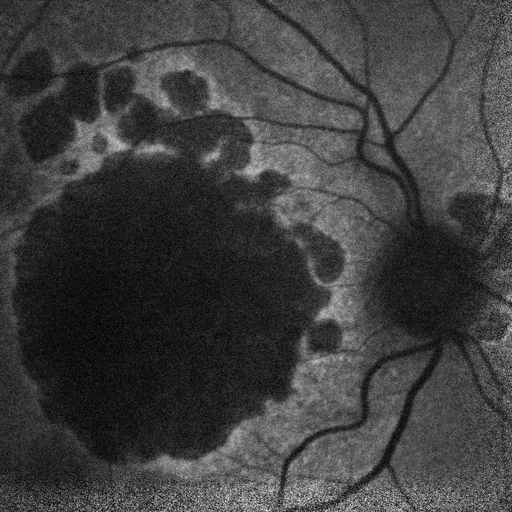

Image 8


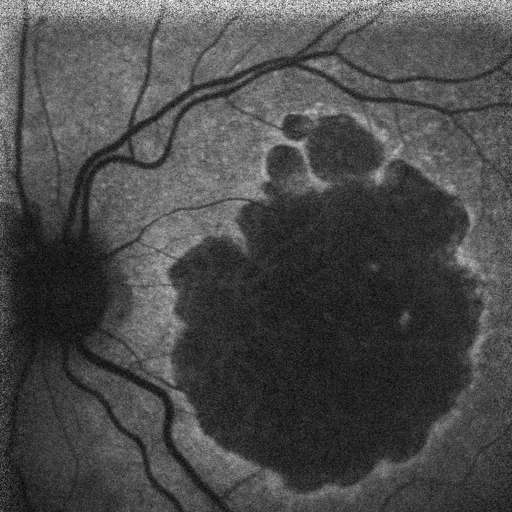

Image 9


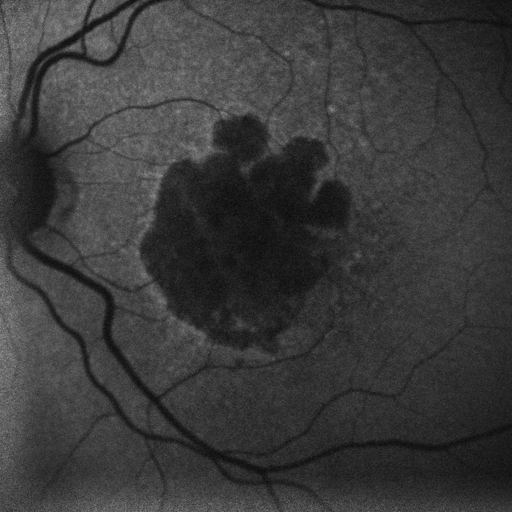

Image 10


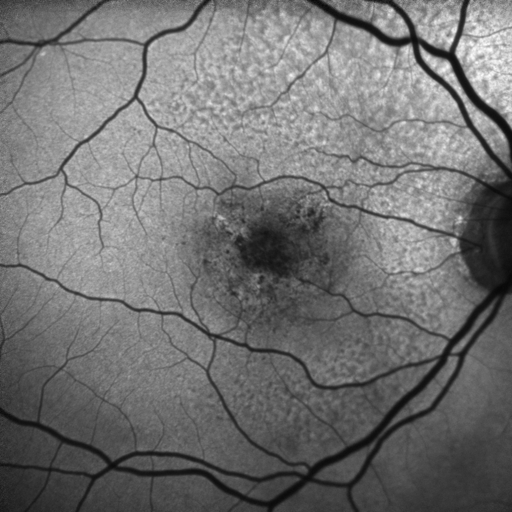

Image 11


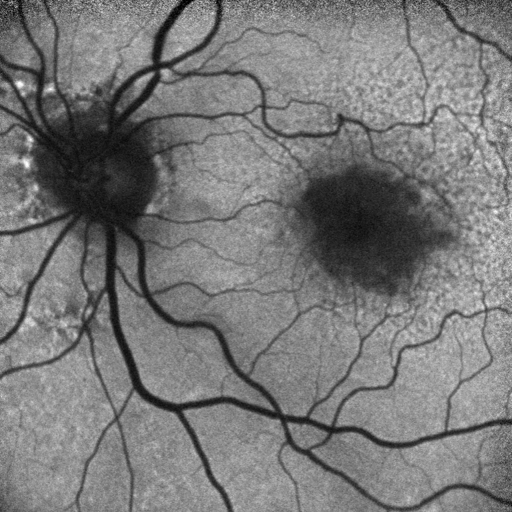

Image 12


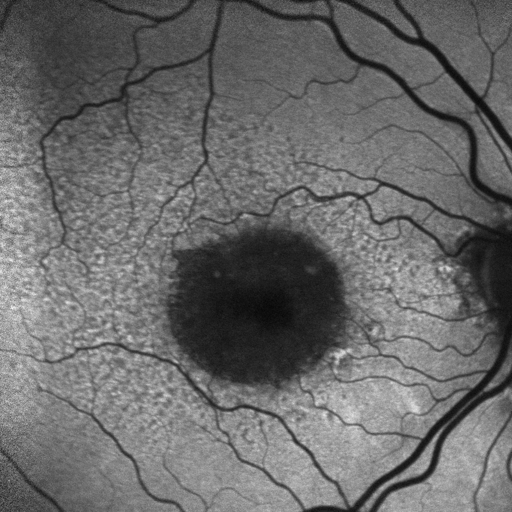

Image 13


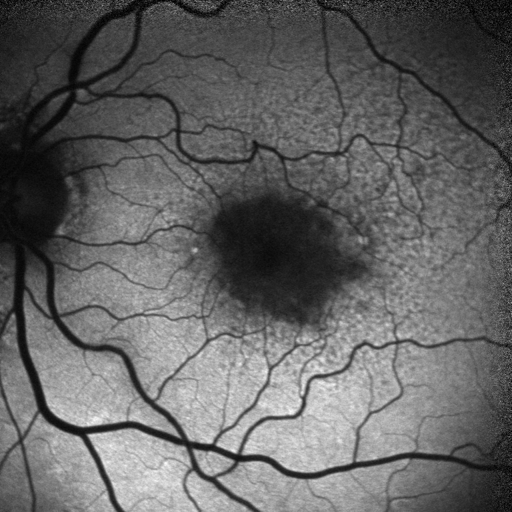

Image 14


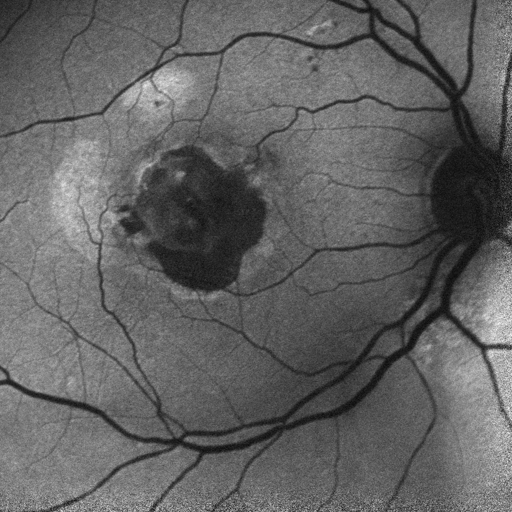

Image 15


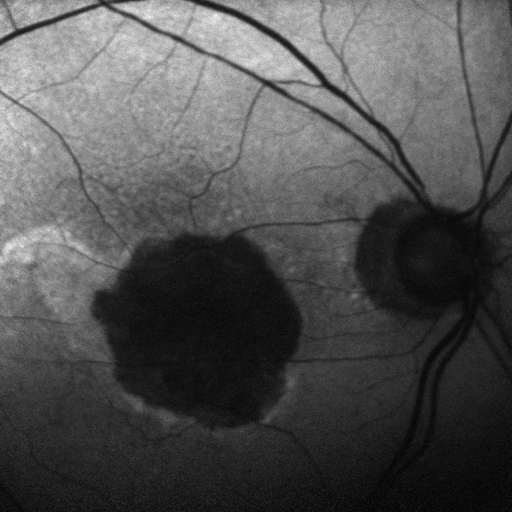

Image 16


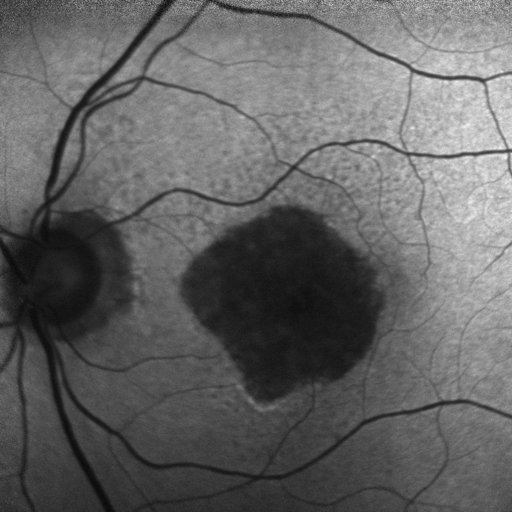

Image 17


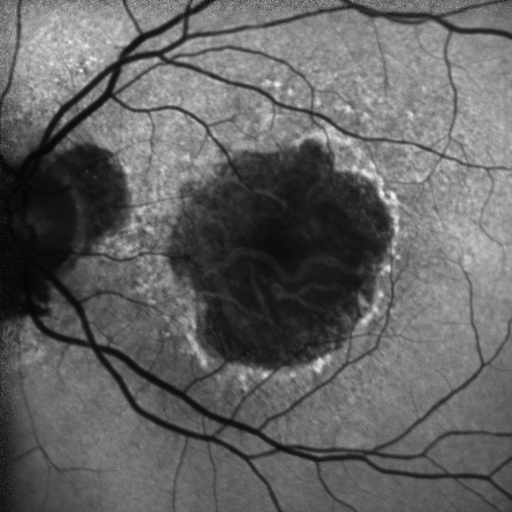

Image 18


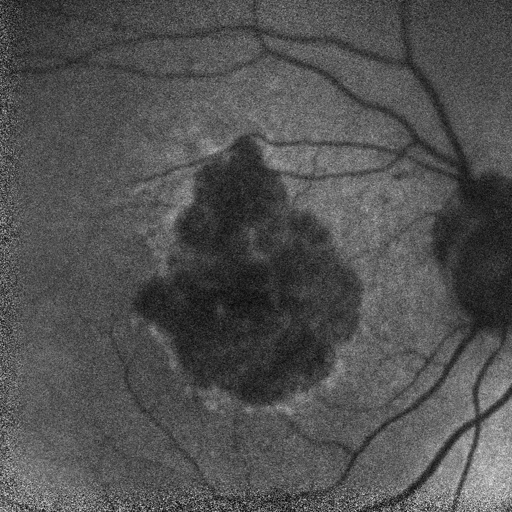

Image 19


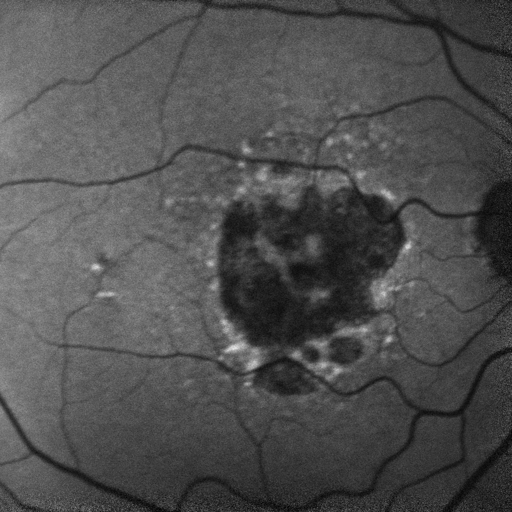

Image 20


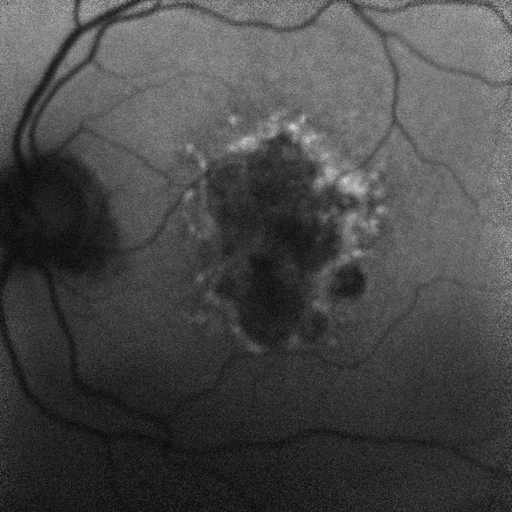

Image 21


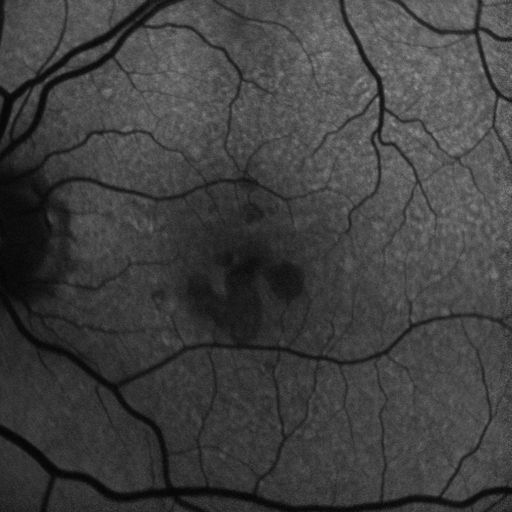

Image 22


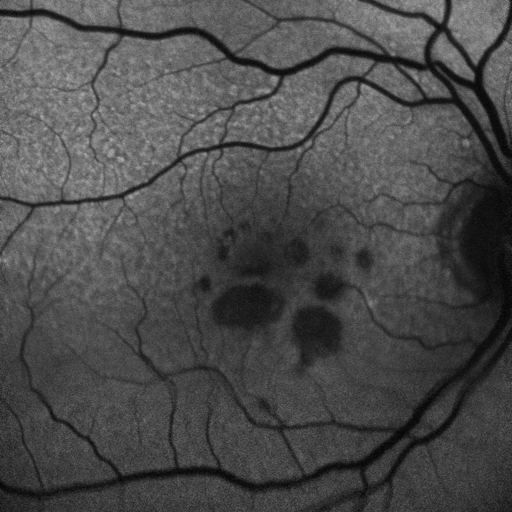

Image 23


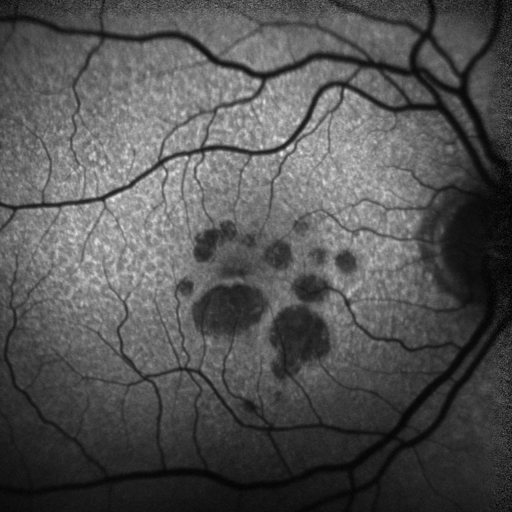

Image 24


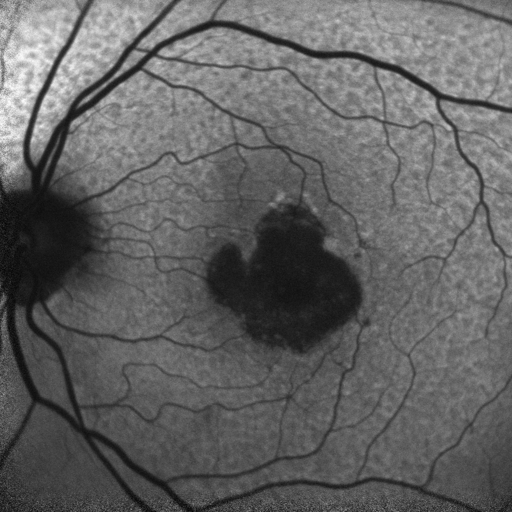

Image 25


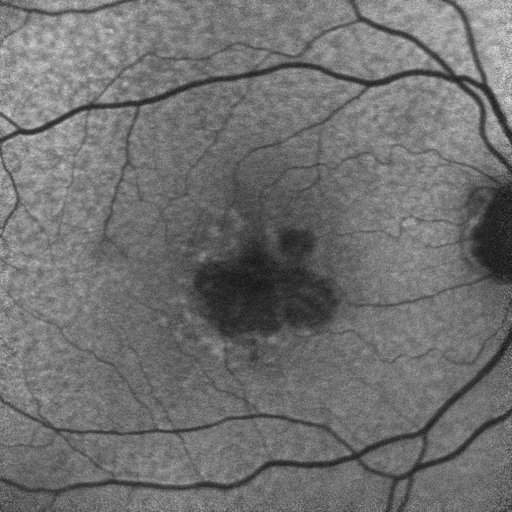

Image 26


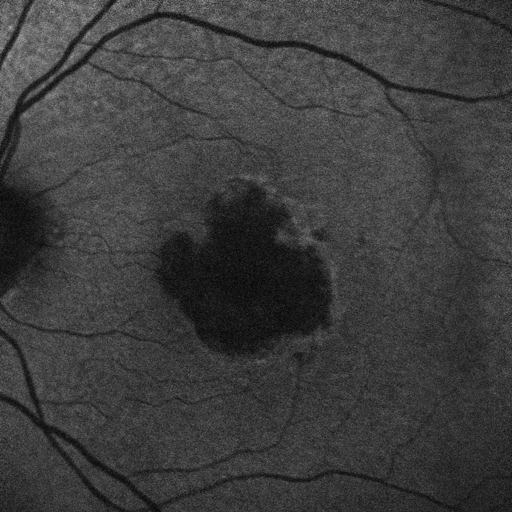

Image 27


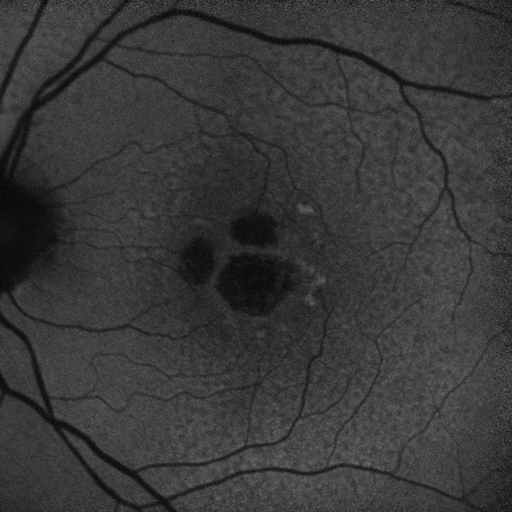

Image 28


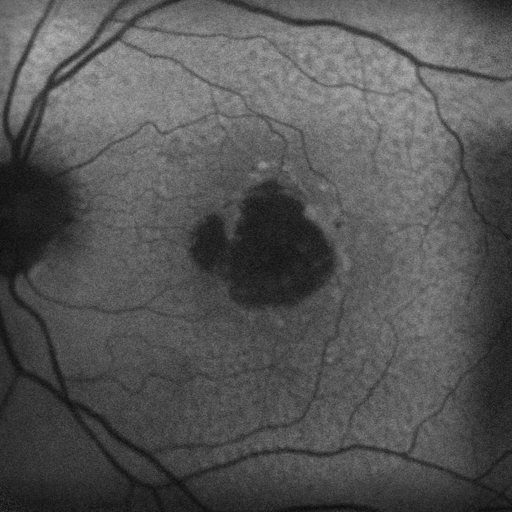

Image 29


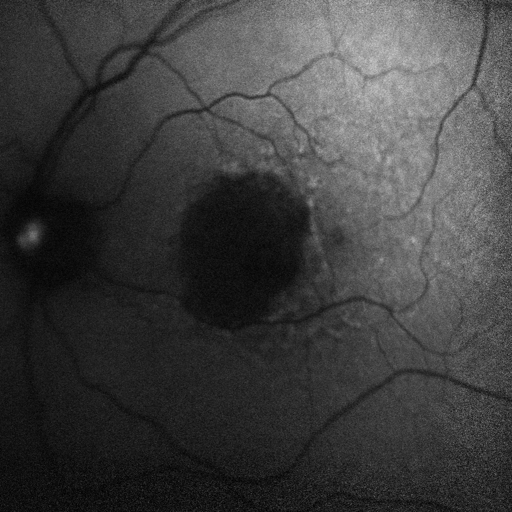

Image 30


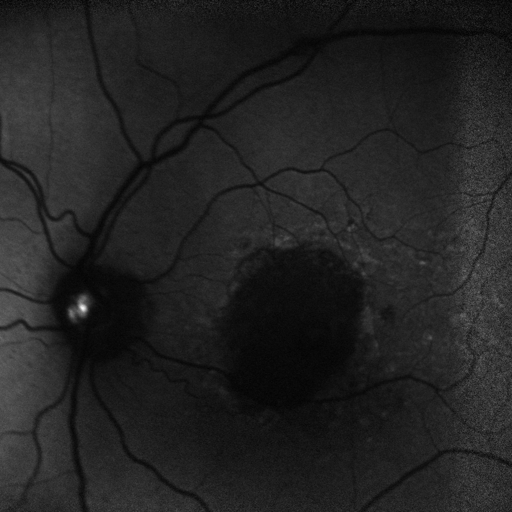

Image 31


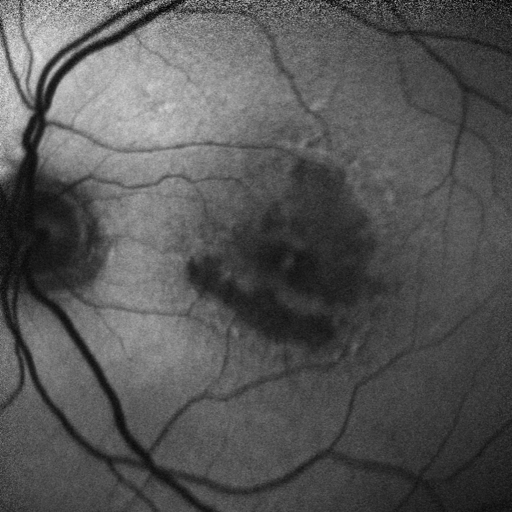

Image 32


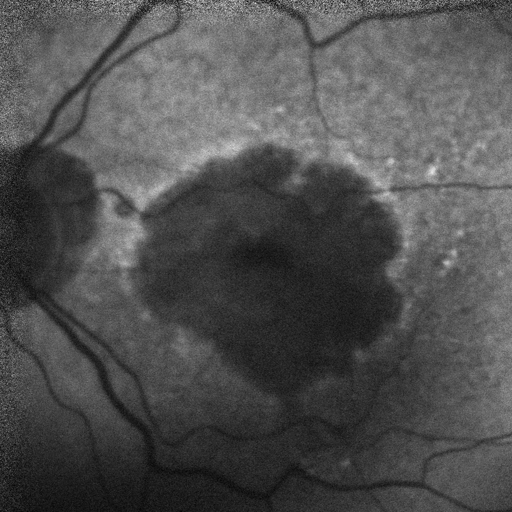

Image 33


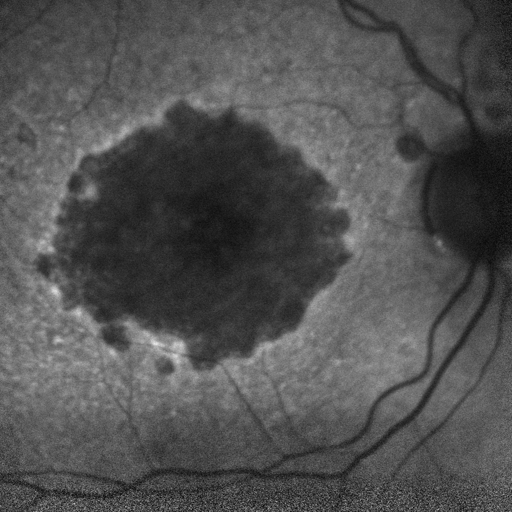

Image 34


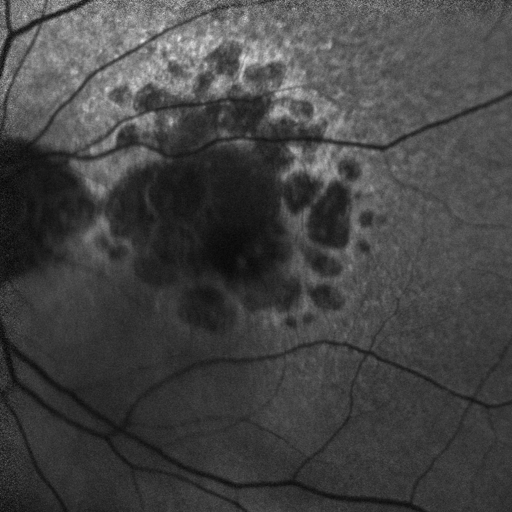

Image 35


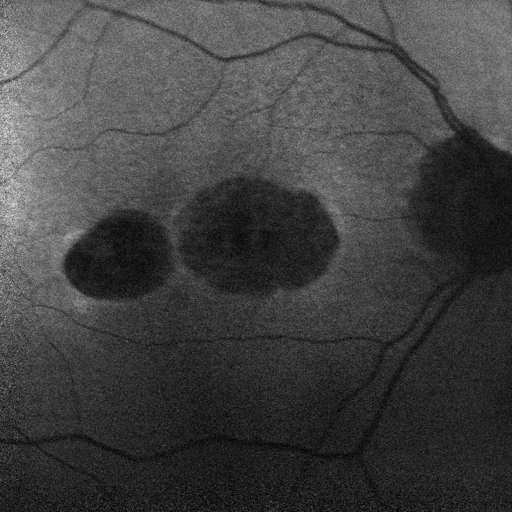

Image 36


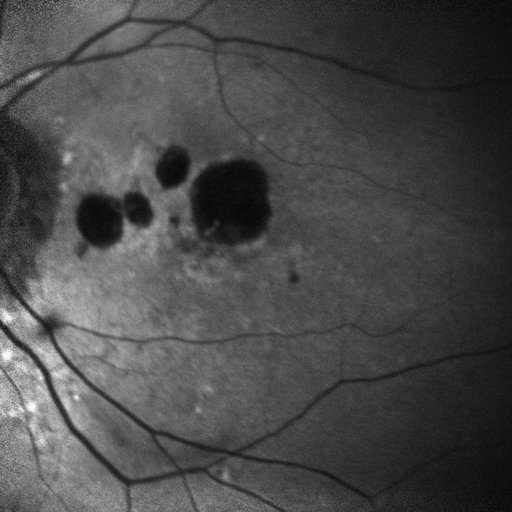

Image 37


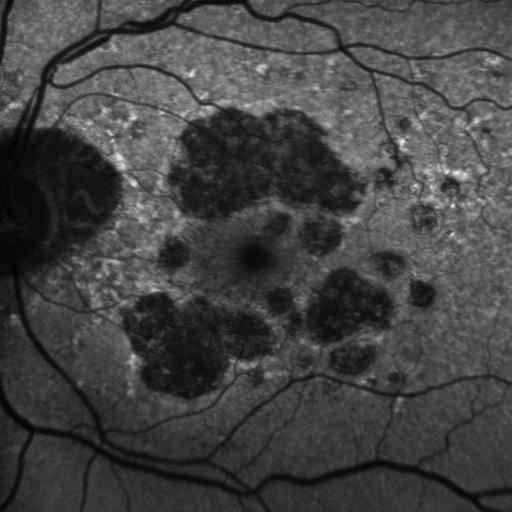

Image 38


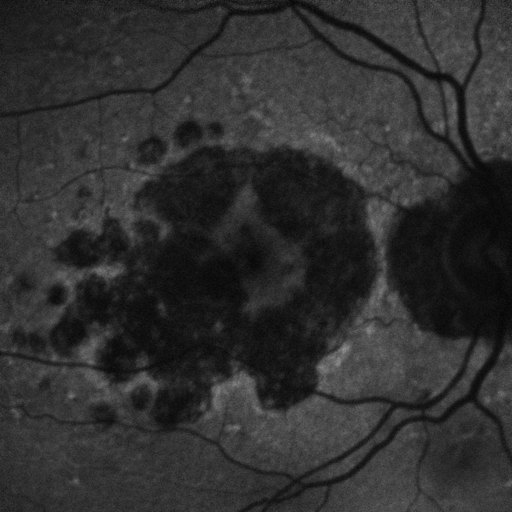

Image 39


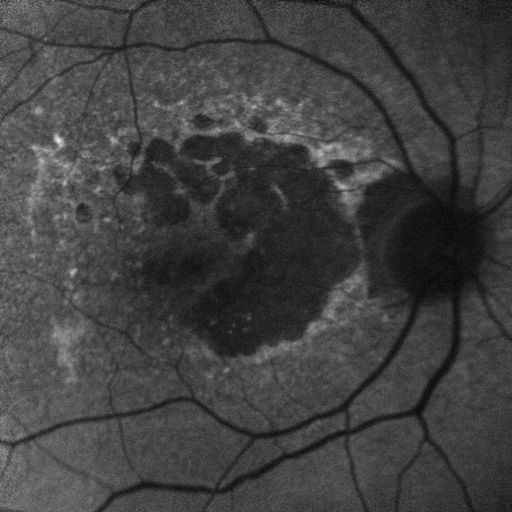

Image 40


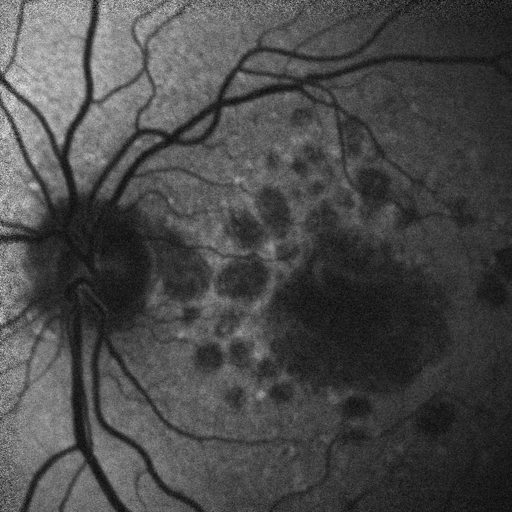

Image 41


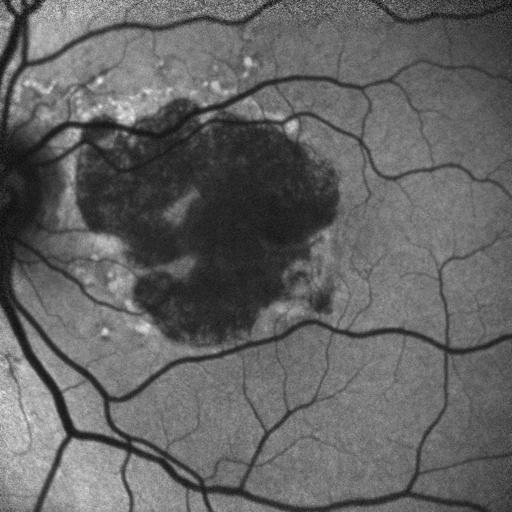

Image 42


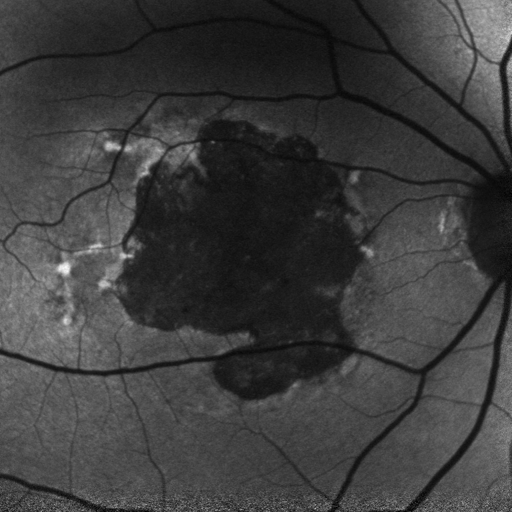

Image 43


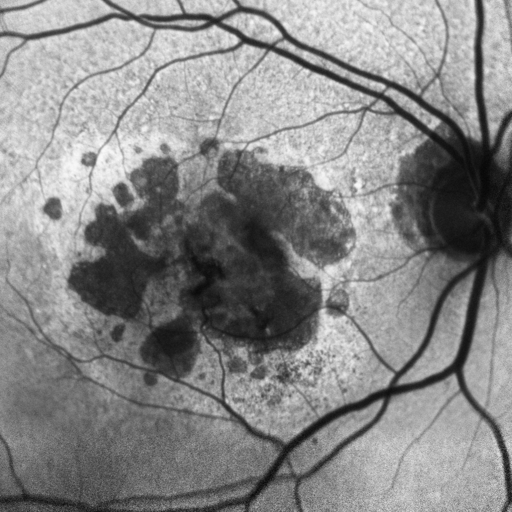

Image 44


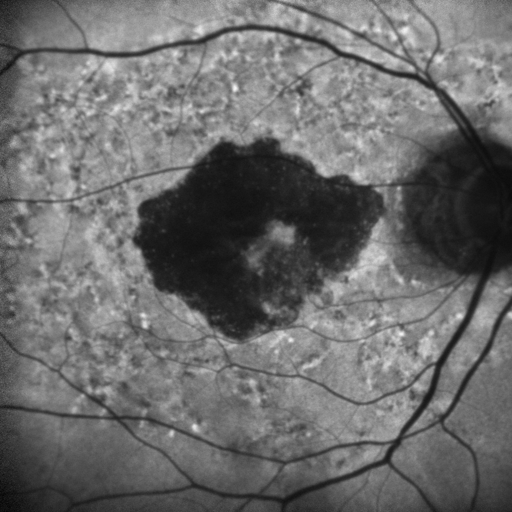

Image 45


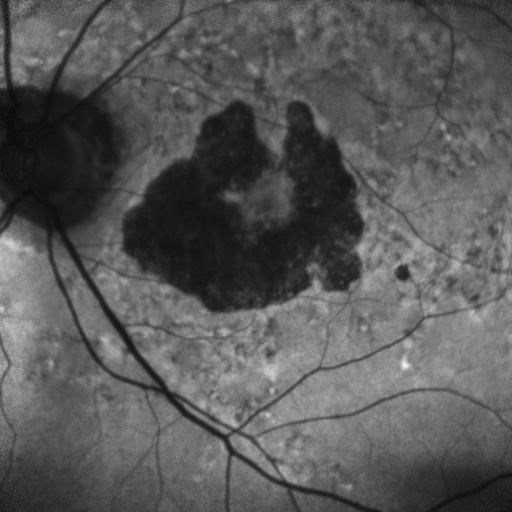

Image 46


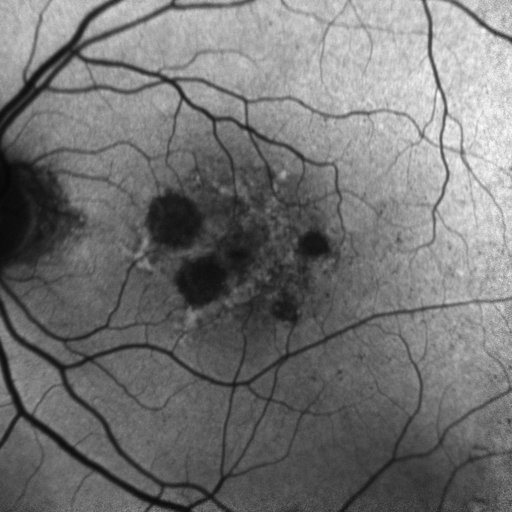

Image 47


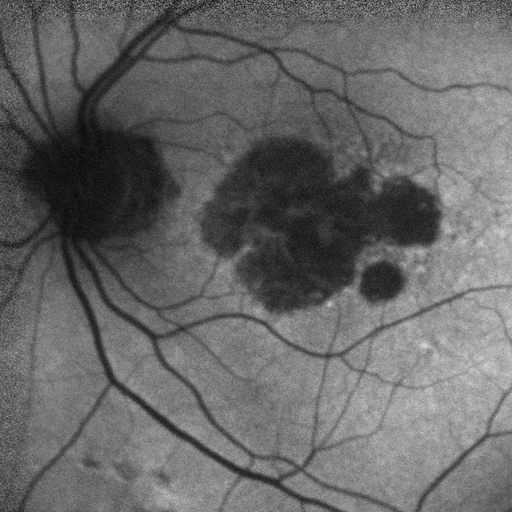

Image 48


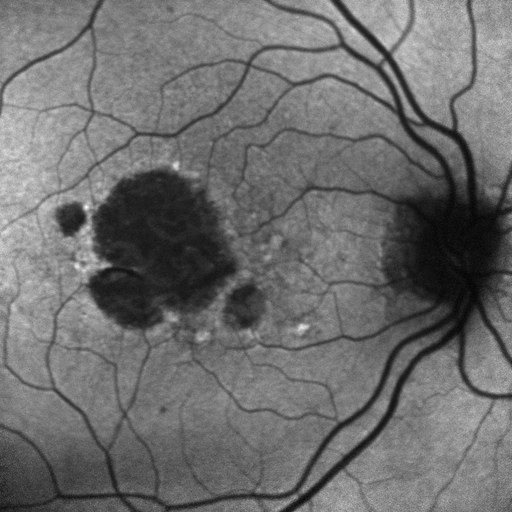

Image 49


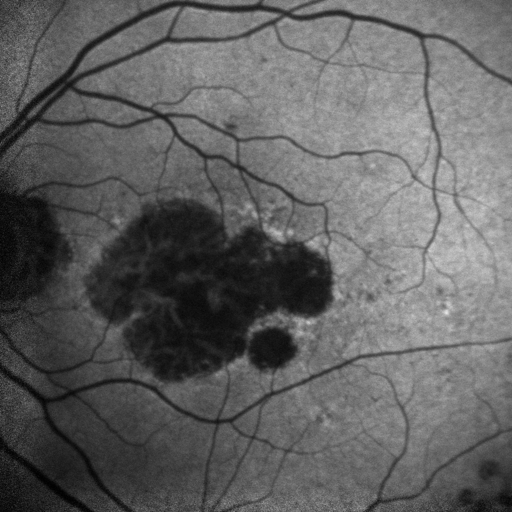

Image 50


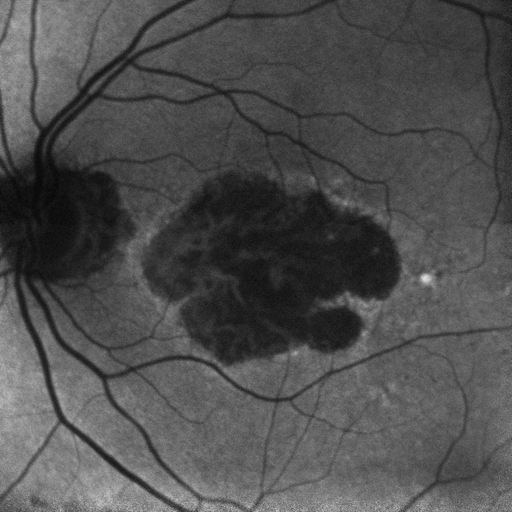

Image 51


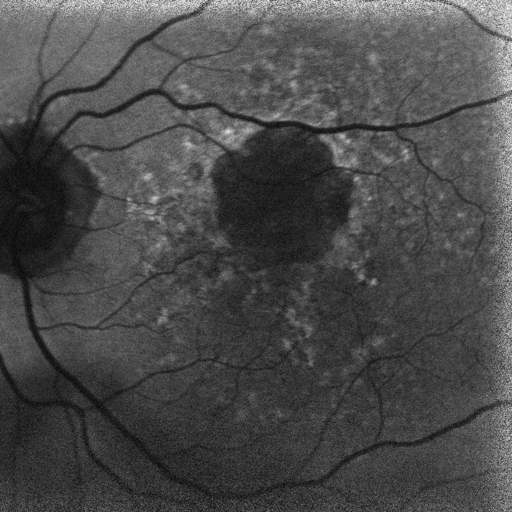

Image 52


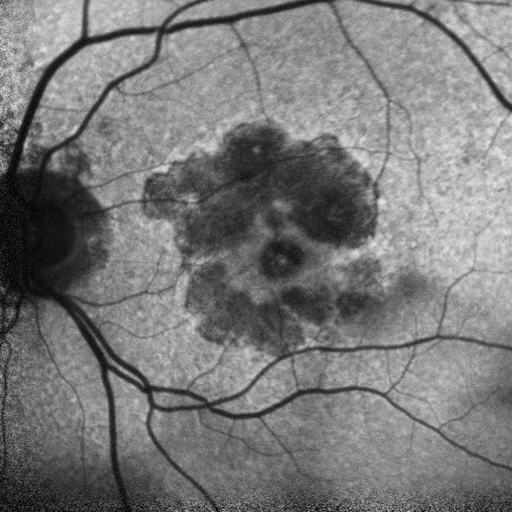

Image 53


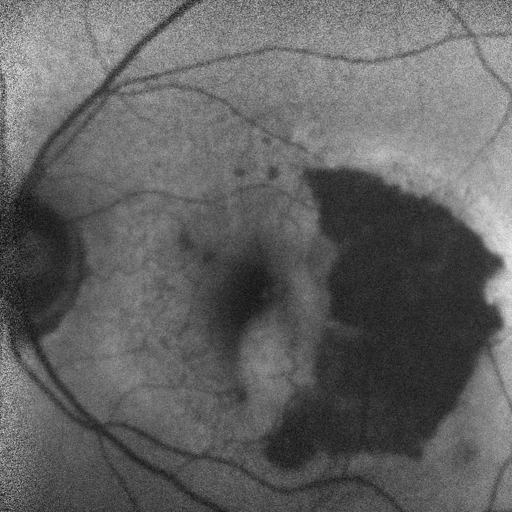

Image 54


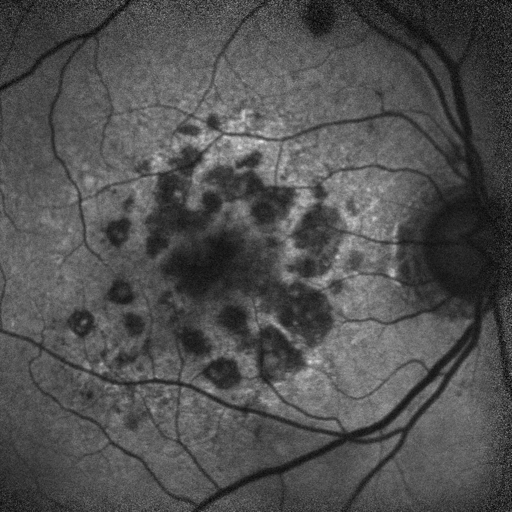

Image 55


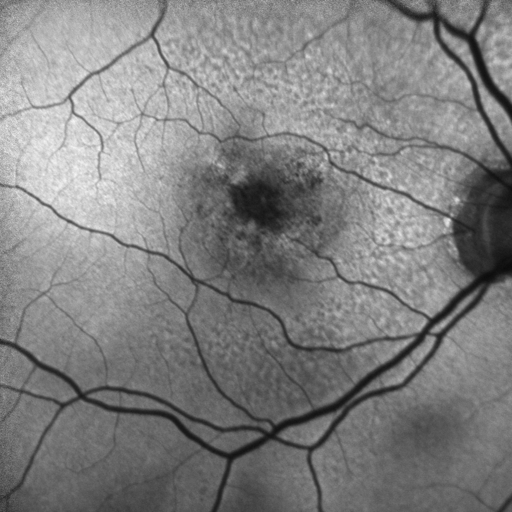

Image 56


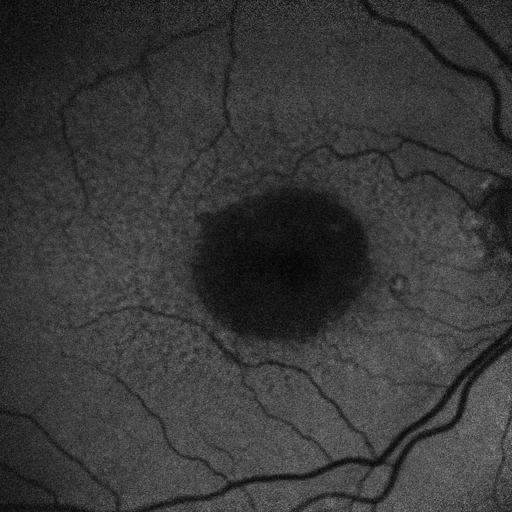

Image 57


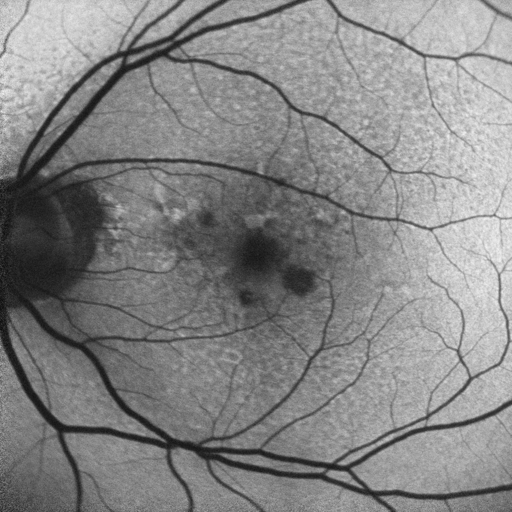

Image 58


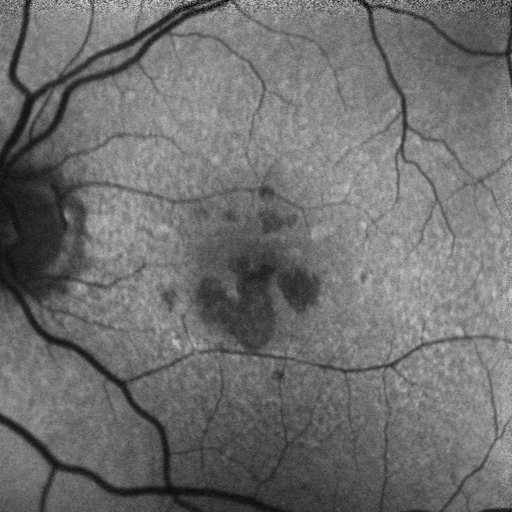

Image 59


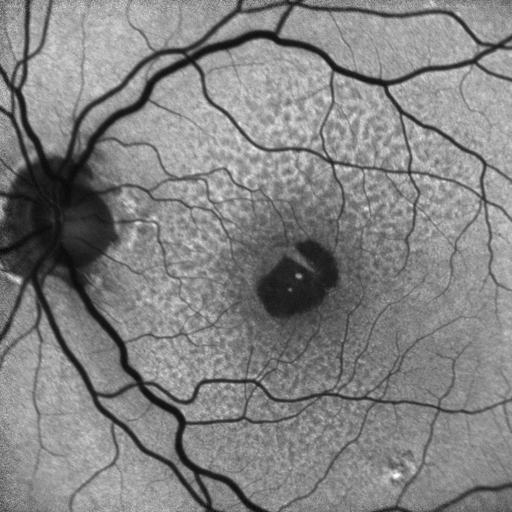

Image 60


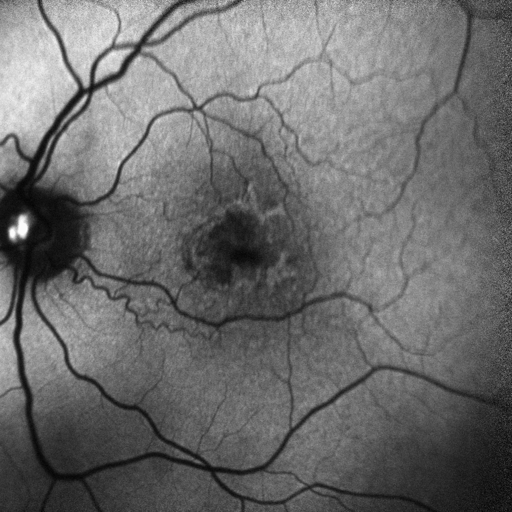

Image 61


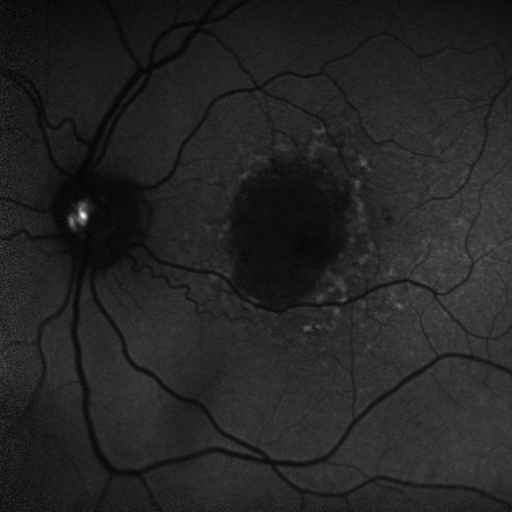

Image 62


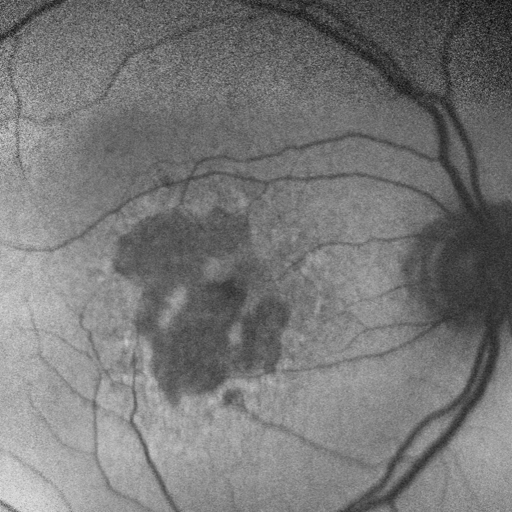

Image 63


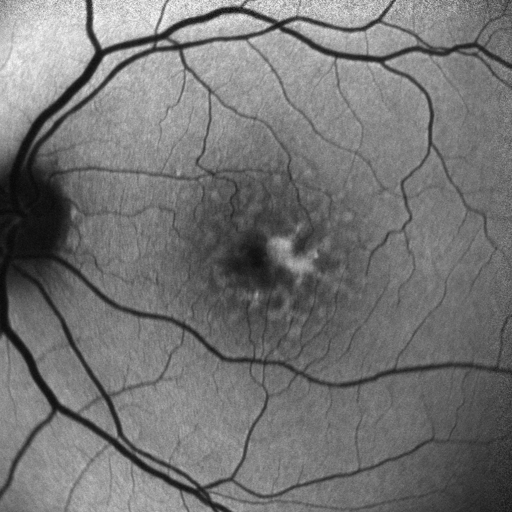

Image 64


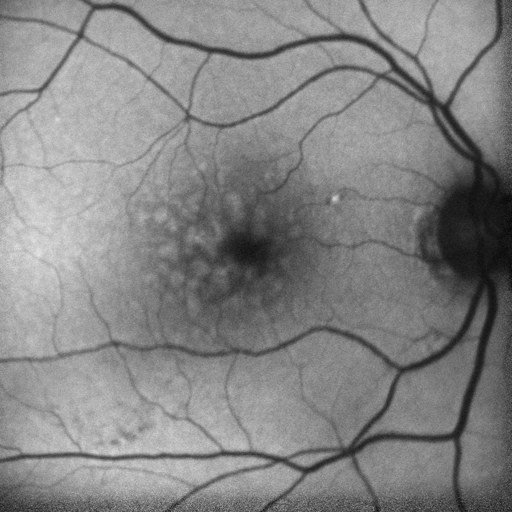

Image 65


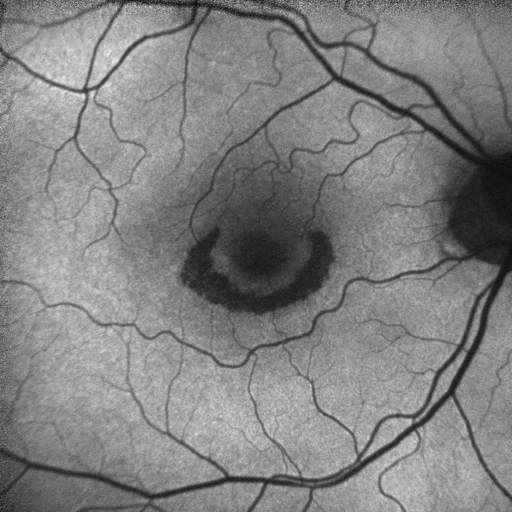

Image 66


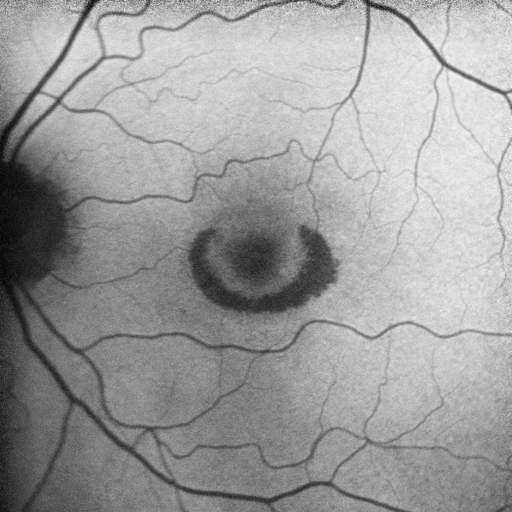

Image 67


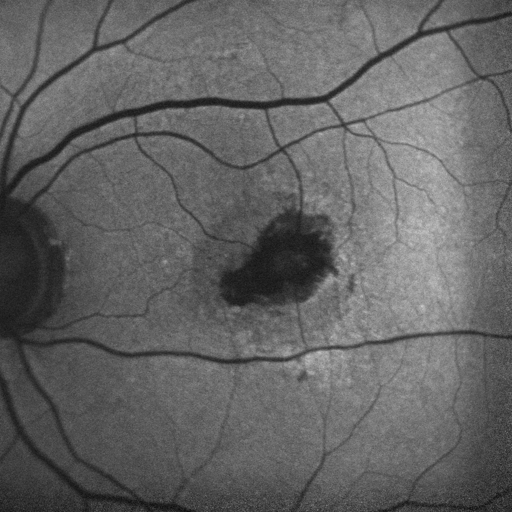

Image 68


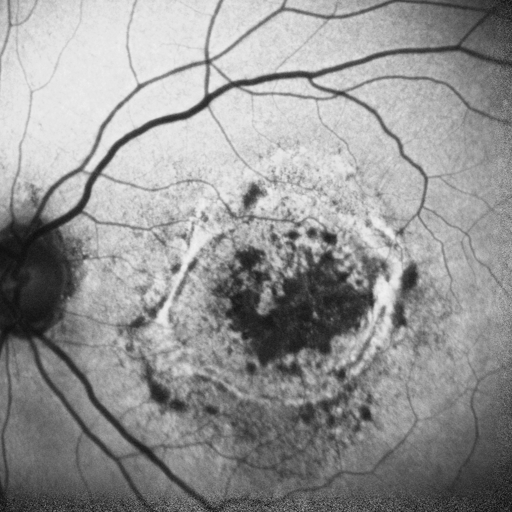

Image 69


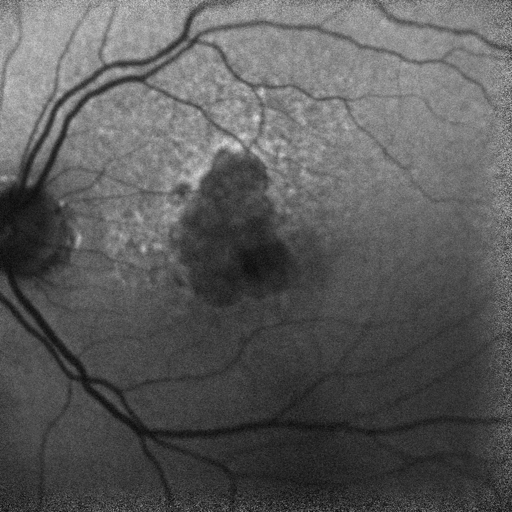

Image 70


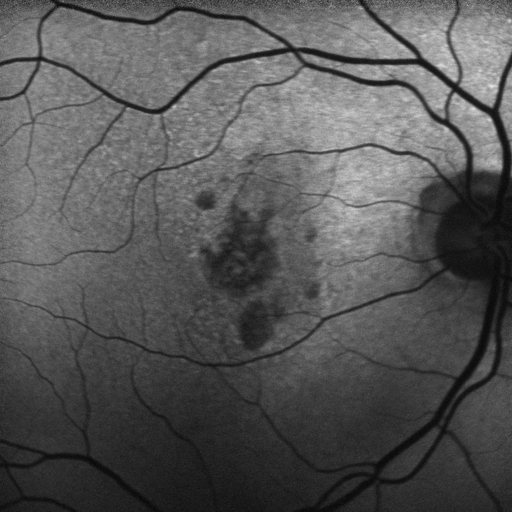

In [30]:
for i, f in enumerate(all_good_quality_files):
    img = Image.open('../' + f).resize((512, 512))
    print(f'Image {i}')
    display(img)

In [35]:
len(df_all_good_quality_files.pat_mrn.unique())

37